In [3]:
import pickle
import numpy as np
import cv2
import json
import matplotlib.pyplot as plt
import json
import math
import os
import os.path as osp
import sys
import time
from datetime import datetime
from typing import Tuple, List, Iterable

import cv2
import matplotlib.pyplot as plt
import numpy as np
import sklearn.metrics
from PIL import Image
from matplotlib import rcParams
from matplotlib.axes import Axes
from pyquaternion import Quaternion
from tqdm import tqdm

from nuscenes.lidarseg.lidarseg_utils import colormap_to_colors, plt_to_cv2, get_stats, \
    get_labels_in_coloring, create_lidarseg_legend, paint_points_label
from nuscenes.utils.data_classes import LidarPointCloud, RadarPointCloud, Box
from nuscenes.utils.geometry_utils import view_points, box_in_image, BoxVisibility, transform_matrix
from nuscenes.utils.map_mask import MapMask
from nuscenes.utils.color_map import get_colormap
# from nuscenes.nuscenes import render_ego_centric_map

import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np
import pylab as pl
from random import random


In [5]:
with (open("./lanes_data/tusimple1_detection.pkl", "rb")) as openfile:
    centernet_detections = pickle.load(openfile)
print(centernet_detections[1])

[{'score': 0.7112239, 'class': 1, 'ct': [633.3988647460938, 272.3545837402344], 'tracking': array([4.963379 , 3.1537476], dtype=float32), 'bbox': array([591.9897 , 234.52118, 666.89233, 302.88998], dtype=float32), 'dep': array([26.702375], dtype=float32), 'dim': array([1.6562486, 1.8880975, 4.4797583], dtype=float32), 'alpha': -1.5296863317489624, 'loc': array([-0.1958507, -1.772255 , 26.702375 ], dtype=float32), 'rot_y': -1.5370207949551333, 'tracking_id': 1, 'age': 1, 'active': 1}, {'score': 0.60119796, 'class': 1, 'ct': [440.6820983886719, 268.04425048828125], 'tracking': array([5.5      , 2.3063965], dtype=float32), 'bbox': array([398.93375, 240.24605, 474.82956, 292.61902], dtype=float32), 'dep': array([31.182556], dtype=float32), 'dim': array([1.515679 , 1.8631358, 4.4380054], dtype=float32), 'alpha': -1.4290672540664673, 'loc': array([-6.9058237, -2.4281783, 31.182556 ], dtype=float32), 'rot_y': -1.6470138623120547, 'tracking_id': 2, 'age': 1, 'active': 1}, {'score': 0.42060608,

In [7]:
with open('./lanes_data/tusimple1_lanes.json') as f:
    lanes_dict = json.load(f)
# print(lanes_dict.keys())
print(lanes_dict['1'])

[[[702, 249], [714, 259], [722, 268], [736, 281], [748, 292], [758, 299], [770, 308], [783, 320], [798, 335], [810, 342], [823, 352], [838, 363], [853, 377], [857, 380], [884, 397], [888, 402], [893, 407], [930, 431], [942, 440], [951, 450], [966, 461], [985, 473], [970, 463], [991, 477], [1014, 493], [1035, 511], [1026, 501], [1047, 521], [1080, 544], [1065, 534], [1102, 559], [1087, 548], [1129, 577], [1177, 608], [1161, 598], [1146, 588], [1200, 624], [1184, 614]], [[622, 249], [586, 261], [553, 272], [522, 282], [503, 289], [478, 298], [443, 309], [399, 322], [378, 330], [345, 339], [314, 350], [269, 364], [262, 366], [204, 383], [191, 388], [116, 411], [94, 418], [62, 427], [29, 438]], [[661, 250], [660, 261], [651, 272], [647, 281], [641, 292], [637, 300], [628, 311], [621, 323], [618, 330], [608, 338], [602, 348], [596, 360], [582, 375], [580, 378], [570, 396], [564, 401], [556, 408], [551, 415], [527, 443], [541, 433], [526, 444], [518, 457], [510, 471], [494, 487], [479, 505],

In [9]:
bbox_trial = centernet_detections[1][0]['bbox'].astype(int)
bbox_trial

array([591, 234, 666, 302])

In [11]:
def bbox_to_lane_id(bbox, lanes_list):
    bottom_edge_center = ((bbox[0]+bbox[2])//2, bbox[3])
    closest_lane_points = []
    for lane in lanes_list:
        lane = np.array(lane)
        y_diffs = np.abs(lane[:,1]-bottom_edge_center[1])
        point = lane[np.argmin(y_diffs)]
        # print(point)
        closest_lane_points.append(point)
        
    x_coords = [point[0] for point in closest_lane_points]
    x_coords+=[0,2000] # add end points for corner lanes
    x_coords.sort()
    # print(x_coords)
    for i in range(1,len(x_coords)):
        if bottom_edge_center[0]>=x_coords[i-1] and bottom_edge_center[0] <= x_coords[i]:
            return i
    return -1

In [13]:
bbox_to_lane_id(bbox_trial, lanes_dict['1'])

2

In [15]:
img = cv2.imread('./test_images/tusimple1/1.jpg')
st = (bbox_trial[0],bbox_trial[1])
en = (bbox_trial[2],bbox_trial[3])
color = (255,0,0)
image = cv2.rectangle(img, st, en, color, 3) 


In [17]:
# plt.imshow(img)
# print(lanes_dict['0'])


In [19]:
with (open("./lanes_data/tusimple1_detection.pkl", "rb")) as openfile:
    centernet_detections = pickle.load(openfile)
with open('./lanes_data/tusimple1_lanes.json') as f:
    lanes_dict = json.load(f)

In [21]:

# def isHitLane(bbox,lanes_list):
#     x1,y1,x2,y2 = bbox
#     obj_width = x1+x2
#     closest_lane_points = []
#     # use bottom center
#     center = ((x1+x2)/2.0, y2)
#     bl,br = ((x1,y2),(x2,y2))
#     for lane in lanes_list:
#         lane = np.array(lane)
#         y_diffs = np.abs(lane[:,1]-center[1])
#         point = lane[np.argmin(y_diffs)]
#         if point[0]>=bl[0] and point[0]<=br[0]:
#             # print(obj_width/100)
#             return True
#     return False


# # video_name = '/home/lance/Desktop/jl/sit_aware/test_videos/tusimple_demo.mp4'
# name = 'tusimple1'
# video_name = '/home/lance/Desktop/jl/sit_aware/test_videos/'+ name + '.mp4'
# cap = cv2.VideoCapture(video_name)

# fourcc = cv2.VideoWriter_fourcc(*'XVID')
# video_folder = '/home/lance/Desktop/jl/sit_aware/test_videos_output/'
# out = cv2.VideoWriter(video_folder + name + '.avi',fourcc, 4, (1280,720))


# cnt = 1
# lane_pair = {str(i) : -1 for i in range(1,100)}

# while(True):
#     # Capture frame-by-frame
#     ret, frame = cap.read()
#     if ret:
#         # prediction per frame
#         preds = centernet_detections[cnt]
#         lanes = lanes_dict[str(cnt)]
#         cv_red = (0,0,255)
#         cv_green = (0,255,0)
#         cv_blue = (255,0,0)
#         cv_orange = (0,128,255)
#         font = 3
#         for pred in preds:
#             if pred['class'] >= 9:
#                 continue

#             x1,y1,x2,y2 = pred['bbox']
#             if y2<270:
#                 continue
#             bbox = pred['bbox']
#             object_id = pred['tracking_id']
#             # assign lane id to box
#             lane_id = bbox_to_lane_id(bboax, lanes)
#             # detect lane crossing
#             if isHitLane(bbox,lanes):
#                 cv2.rectangle(frame,(x1,y1),(x2,y2),cv_red,font)
#                 frame = cv2.putText(frame, 'Changing to '+ str(lane_id), (int(x2-50),int(y1-5)), 2,
#                    1, cv_red, 2, cv2.LINE_AA)
#             else:
#                 # draw box on img
#                 cv2.rectangle(frame,(x1,y1),(x2,y2),cv_green,font)
#                 frame = cv2.putText(frame, str(lane_id), (int(x2-50),int(y1-5)), 2,
#                    1, cv_red, 2, cv2.LINE_AA)
#         cv2.imshow('frame',frame)
#         out.write(frame)
#     else:
#         break
#     if cv2.waitKey(250) & 0xFF == ord('q'):
#         break
#     cnt+=1

# # When everything done, release the capture
# cap.release()
# out.release()
# cv2.destroyAllWindows()


In [39]:
# run all cells to include libs, and the main code for distance measurements starts from here


def geth(img_h_half,y1):
    h = y1 - img_h_half
    return h

def drawBbox(box,ax,i,edge_color='b'):
    x1,y1,x2,y2 = box
    width = x2-x1
    height = y2-y1
    rect = patches.Rectangle((x1,y1),width,height,linewidth=1,edgecolor= edge_color,fill = False)
    ax.add_patch(rect)
    ax.annotate(i,(x1,y1),color='r')
    return h


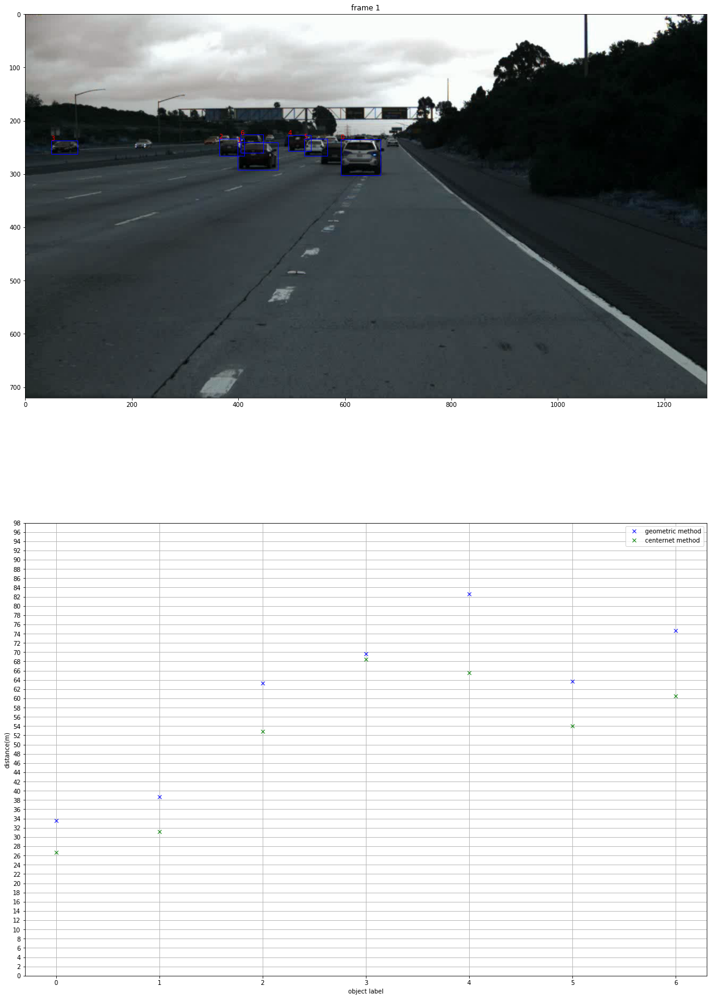

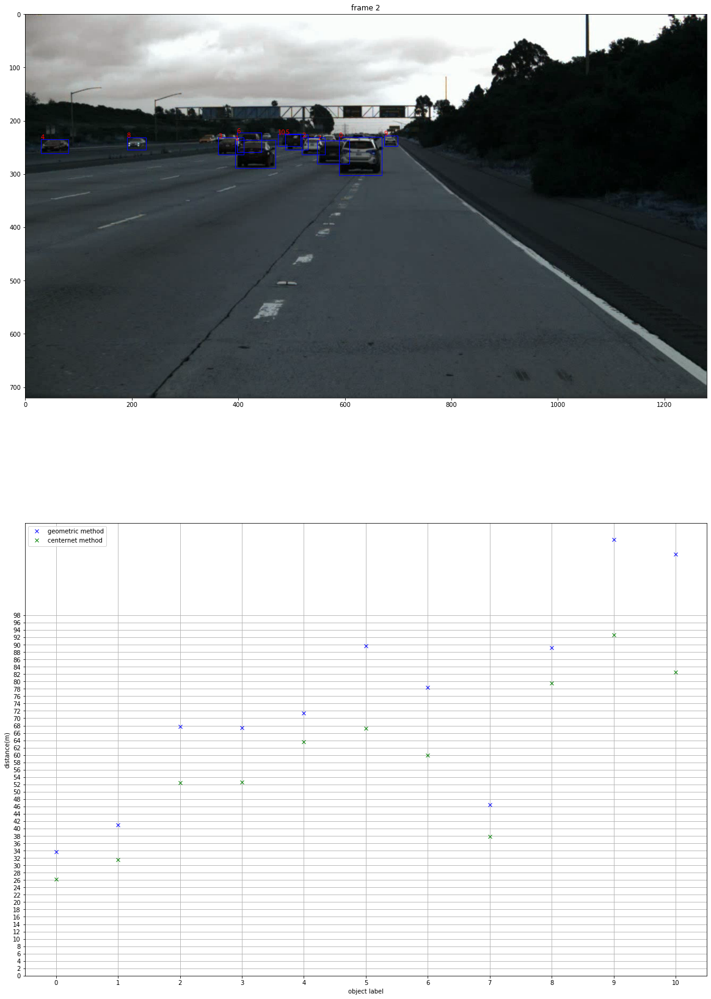

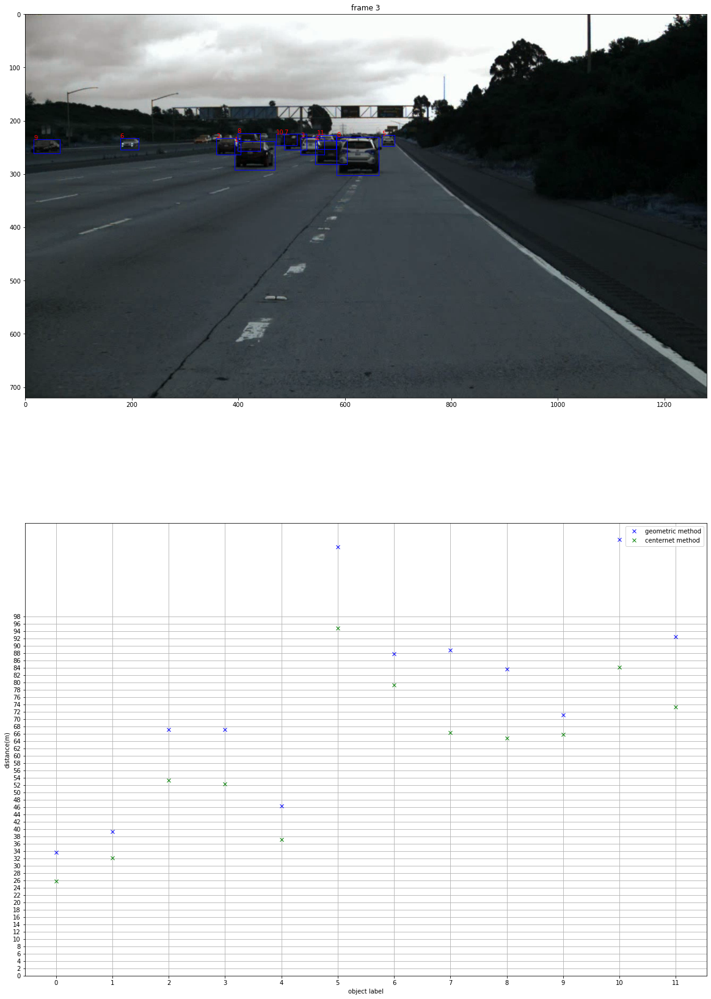

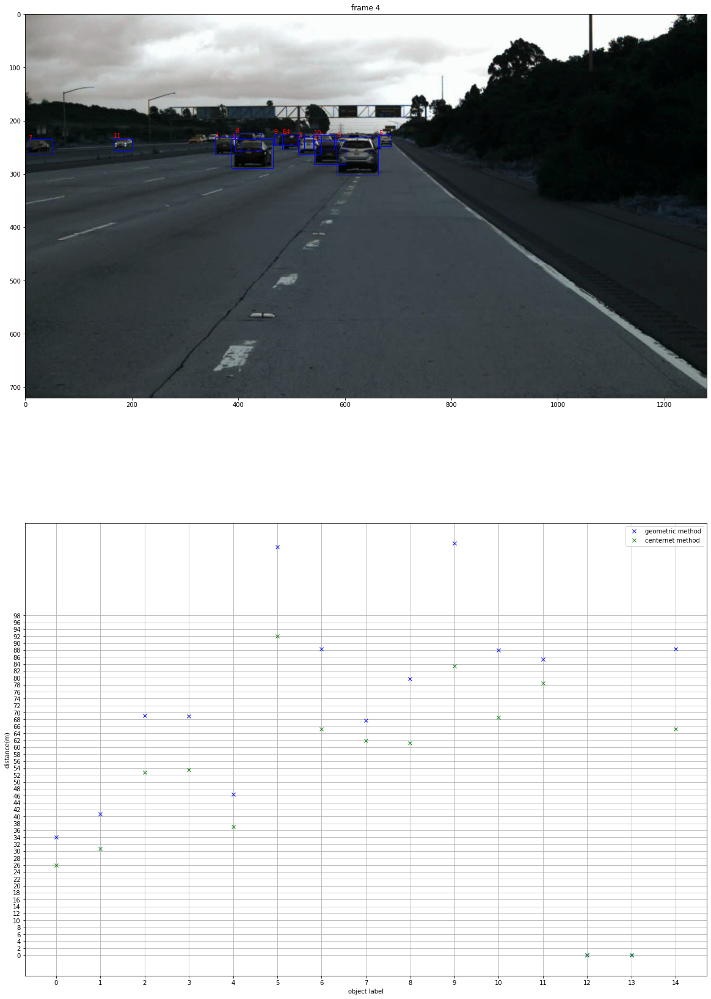

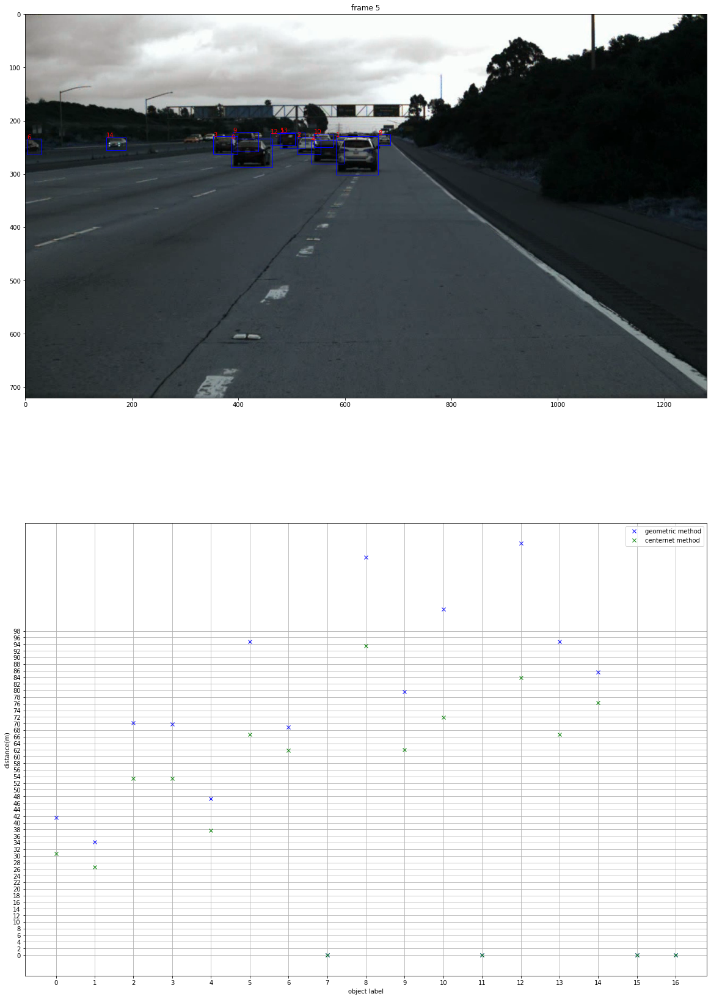

...

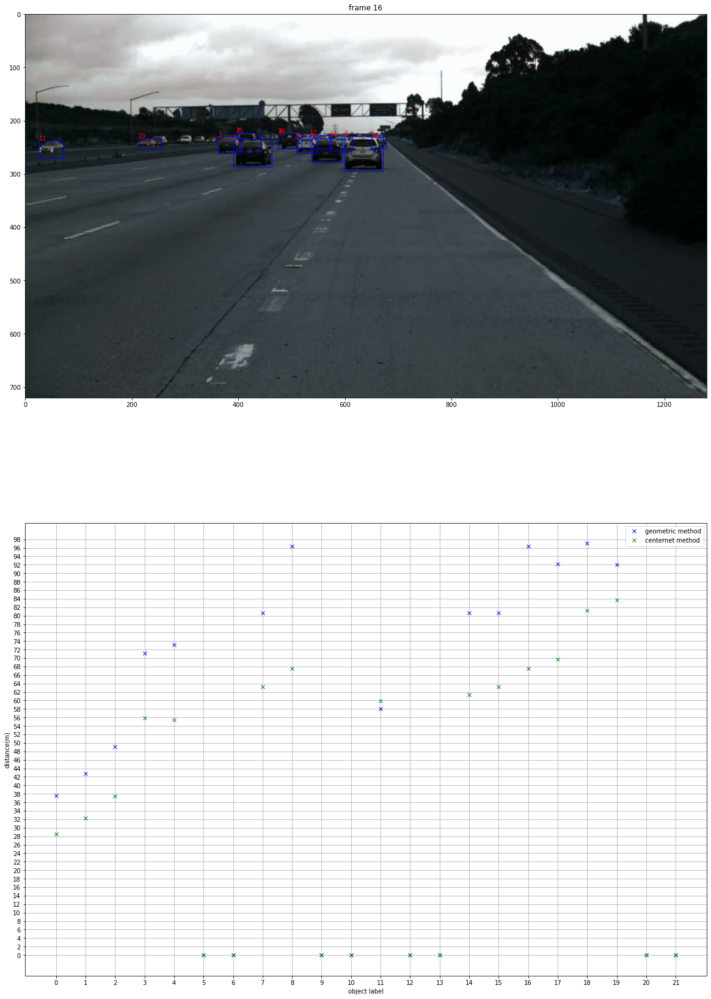

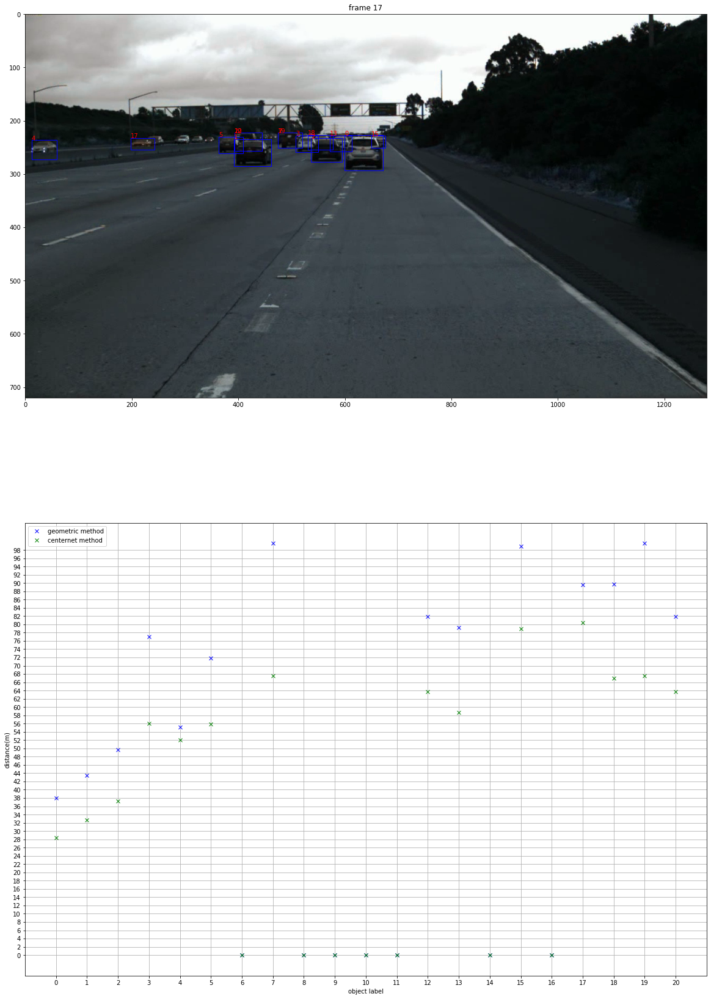

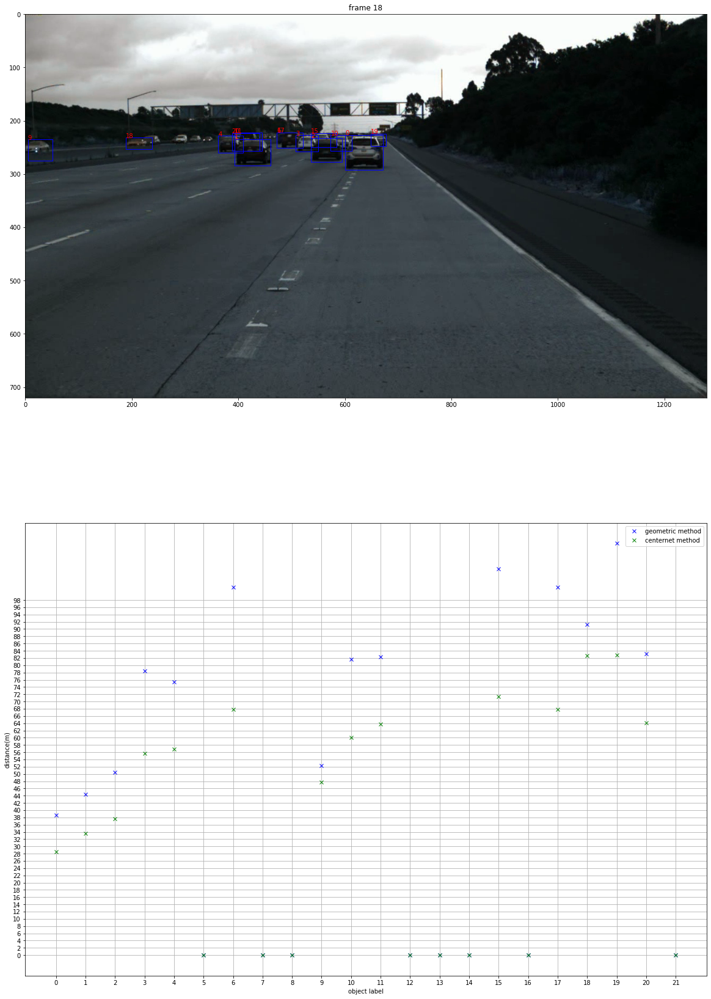

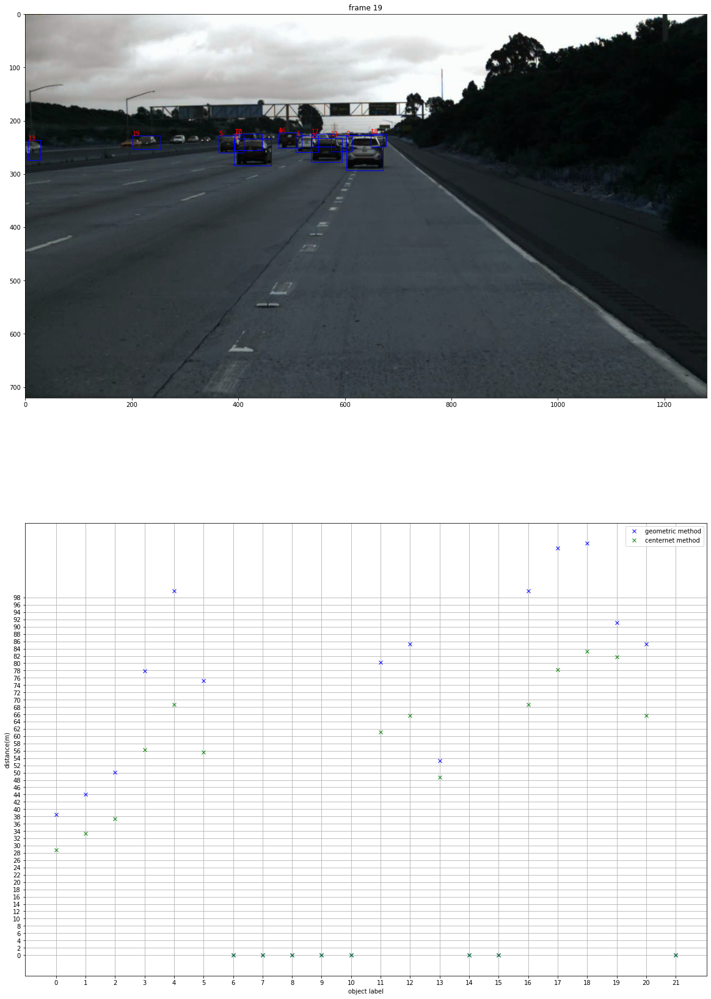

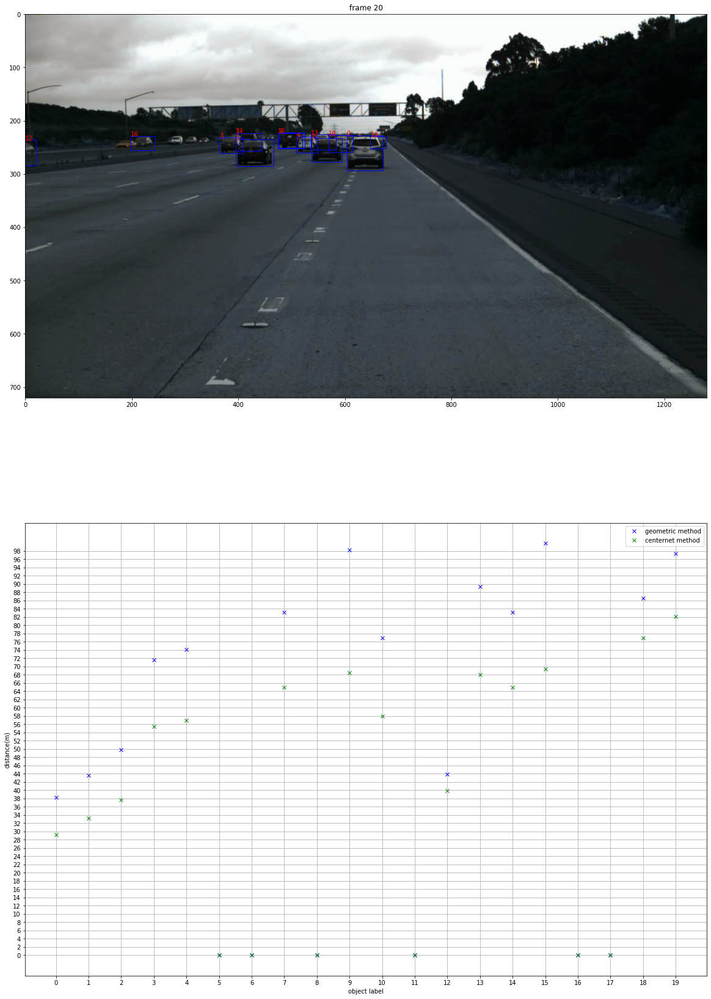

In [40]:
import copy
import pdb
# output: plot distance in matplotlib graph
def isHitLane(bbox,lanes_list):
    x1,y1,x2,y2 = bbox
    obj_width = x1+x2
    closest_lane_points = []
    # use bottom center
    center = ((x1+x2)/2.0, y2)
    bl,br = ((x1,y2),(x2,y2))
    for lane in lanes_list:
        lane = np.array(lane)
        y_diffs = np.abs(lane[:,1]-center[1])
        point = lane[np.argmin(y_diffs)]
        if point[0]>=bl[0] and point[0]<=br[0]:
            # print(obj_width/100)
            return True
    return False


H = 1.80 #camera height in m
K = np.array([[714.15,0,675.58],[0,710.37,376.26],[0,0,1]]) # K
f = 714.15 #f
img_h_half = 376.26

# specify the file location
# video_name = '/home/lance/Desktop/jl/sit_aware/test_videos/tusimple_demo.mp4'
name = 'tusimple1'
video_name = '/home/lance/Desktop/jl/sit_aware/test_videos/'+ name + '.mp4'
cap = cv2.VideoCapture(video_name)

fourcc = cv2.VideoWriter_fourcc(*'XVID')
video_folder = '/home/lance/Desktop/jl/sit_aware/test_videos_output/'
out = cv2.VideoWriter(video_folder + name + '.avi',fourcc, 4, (1280,720))


cnt = 1
lane_pair = {str(i) : -1 for i in range(1,100)}
img_w, img_h = 1280,720
while(True):
    # Capture frame-by-frame
    ret, frame = cap.read()

    if ret:
        # raw_frame = copy.deepcopy(frame)
        raw_frame = frame.copy()
        # prediction per frame
        preds = centernet_detections[cnt]
        lanes = lanes_dict[str(cnt)]
        cv_red = (0,0,255)
        cv_green = (0,255,0)
        cv_blue = (255,0,0)
        cv_orange = (0,128,255)
        font = 3
        cn_distances = np.zeros(len(preds))
        trig_distances = np.zeros(len(preds))
        fig, (ax1,ax2) = plt.subplots(2, 1, figsize=(20, 30))
        # pdb.set_trace()
        for i in range(len(preds)):

            pred = preds[i]
            if pred['class'] >= 9:
                continue

            x1,y1,x2,y2 = pred['bbox']

            # if y2<270:
                # continue
            bbox = pred['bbox']
            object_id = pred['tracking_id']
            # assign lane id to box
            lane_id = bbox_to_lane_id(bbox, lanes)
            # detect lane crossing

            if isHitLane(bbox,lanes):
                cv2.rectangle(frame,(x1,y1),(x2,y2),cv_red,font)
                frame = cv2.putText(frame, 'Changing to '+ str(lane_id), (int(x2-50),int(y1-5)), 2,
                   1, cv_red, 2, cv2.LINE_AA)
            else:
                # draw box on img
                cv2.rectangle(frame,(x1,y1),(x2,y2),cv_green,font)
                frame = cv2.putText(frame, str(lane_id), (int(x2-50),int(y1-5)), 2,
                   1, cv_red, 2, cv2.LINE_AA)


            # estimate and visualize distance
            cn_dep = pred['dep']
            h = geth(img_h_half,y2)
            # pdb.set_trace()
            # trig_dep = f * H / h
            theta = 12*np.pi/180.0
            trig_dep = H/(np.tan(theta + np.arctan(h/f) ))
            trig_dep *= 2
            cn_distances[i] = cn_dep
            trig_distances[i] = trig_dep
            drawBbox(pred['bbox'],ax1,i)
        # matplotlib
        # pdb.set_trace()
        ax1.imshow(raw_frame)
        ax1.set_title("frame "+ str(cnt))
        # ax2.plot(xs,y,'xr',label='ground truth')
        xs = np.arange(0,len(preds),1)
        ax2.plot(xs,trig_distances,'xb',label='geometric method')
        ax2.plot(xs,cn_distances,'xg',label='centernet method')
        ax2.set_xlabel("object label")
        ax2.set_ylabel("distance(m)")
        ax2.set_xticks(np.arange(0,max(xs)+1,1))
        ax2.set_yticks(np.arange(0,100,2))
        ax2.grid()
        ax2.legend()
        # fig.show()
        # print(pred_distances)
        fig.savefig("./results/"+name+'/' + str(cnt)+ ".png")
     

        # opencv
        # cv2.imshow('frame',frame)
        out.write(frame)
    else:
        break
    if cv2.waitKey(250) & 0xFF == ord('q'):
        break
    cnt+=1

# When everything done, release the capture
cap.release()
out.release()
cv2.destroyAllWindows()


In [64]:
print(f)

714.15


In [65]:
714.15/2

357.075